# Body signals of smoking
#

## Introduction:

#### This dataset is a collection of basic health biological signal data.
#### The goal is to determine the presence or absence of smoking through bio-signals.։

In [45]:
#   Attribute	                Description 

# ID	                    Index	                                      
# Gender	                Gender of the individual		                    
# Age	                    Age of the individual (in 5-year intervals)
# Height	                Height of the individual (in cm)		                         
# Weight	                Weight of the individual (in kg)		                         
# Waist	                    Waist circumference (in cm)	                   
# Eyesight (Left)	        Eyesight measurement for the left eye	
# Eyesight (Right)	        Eyesight measurement for the right eye		          
# Hearing (Left)	        Hearing measurement for the left ear       	    
# Hearing (Right)	        Hearing measurement for the right ear		                   
# Systolic BP	            Systolic blood pressure	                          
# Diastolic BP	            Diastolic blood pressure	                      
# Fasting Blood Sugar	    Fasting blood sugar level	 	                       
# Cholesterol (Total)	    Total cholesterol level		               
# Triglyceride	            Triglyceride level		                      
# HDL Cholesterol	        HDL cholesterol level		                 
# LDL Cholesterol	        LDL cholesterol level		                 
# Hemoglobin	            Hemoglobin level		                      
# Urine Protein	            Presence of protein in urine          
# Serum Creatinine	        Serum creatinine level	            
# AST	                    Glutamic oxaloacetic transaminase (AST) level	         
# ALT	                    Glutamic oxaloacetic transaminase (ALT) level	
# GTP	                    γ-GTP level		                               
# Oral Exam Status	        Status of oral examination	    	                  
# Dental Caries         	Presence of dental cavities		           
# Tartar Status	            Presence of dental tartar		                   
# Smoking Status	        Indicates if the individual is a smoker		           

In [7]:
import warnings
warnings.filterwarnings('ignore')

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random

# for encoding
from sklearn.preprocessing import LabelEncoder

# for vizualization
import itertools
import math

# for plotting
!pip install plotly pandas
from plotly import express as px
from plotly import graph_objects as go
from plotly.subplots import make_subplots

#for modeling
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import make_classification
from sklearn.metrics import accuracy_score, f1_score, classification_report, precision_score, recall_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix
from sklearn import preprocessing
from sklearn.metrics import max_error

# for overfitting 
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold

#for roc
from sklearn.metrics import roc_curve, auc

#for neural network model
!pip install tensorflow
from sklearn.preprocessing import StandardScaler
from tensorflow import keras
from tensorflow.keras import layers

In [9]:
# To display the whole columns
pd.set_option('display.max_columns', None)
# To set the width
pd.set_option('display.width', 1000)

## Examining the data

In [10]:
# Loading Dataset
data = pd.read_csv("smoking.csv")
data

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,F,40,170,65,75.0,0.9,0.9,1.0,1.0,110.0,68.0,89.0,213.0,99.0,75.0,118.0,12.3,1.0,0.6,14.0,7.0,10.0,Y,1,Y,0
55688,55681,F,45,160,50,70.0,1.2,1.2,1.0,1.0,101.0,62.0,89.0,166.0,69.0,73.0,79.0,14.0,1.0,0.9,20.0,12.0,14.0,Y,0,Y,0
55689,55683,F,55,160,50,68.5,1.0,1.2,1.0,1.0,117.0,72.0,88.0,158.0,77.0,79.0,63.0,12.4,1.0,0.5,17.0,11.0,12.0,Y,0,N,0
55690,55684,M,60,165,60,78.0,0.8,1.0,1.0,1.0,133.0,76.0,107.0,210.0,79.0,48.0,146.0,14.4,1.0,0.7,20.0,19.0,18.0,Y,0,N,0


In [53]:
# Basic information about the dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55692 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   55692 non-null  int64  
 1   gender               55692 non-null  object 
 2   age                  55692 non-null  int64  
 3   height(cm)           55692 non-null  int64  
 4   weight(kg)           55692 non-null  int64  
 5   waist(cm)            55692 non-null  float64
 6   eyesight(left)       55692 non-null  float64
 7   eyesight(right)      55692 non-null  float64
 8   hearing(left)        55692 non-null  float64
 9   hearing(right)       55692 non-null  float64
 10  systolic             55692 non-null  float64
 11  relaxation           55692 non-null  float64
 12  fasting blood sugar  55692 non-null  float64
 13  Cholesterol          55692 non-null  float64
 14  triglyceride         55692 non-null  float64
 15  HDL                  55692 non-null 

In [54]:
# Get the number of missing values
data.isnull().sum().sum()

0

In [55]:
# Check whether there are duplicate rows in the DataFrame or not
data.duplicated().any()

False

In [56]:
# Check if all values ​​in ID column are unique or not
data["ID"].unique().any()

# As a result we see that there are no duplicate values ​​and the ID is unique

True

In [24]:
def value_counts_func(data):
    value_counts_dict = {}
    for i in data.columns:
        value_counts_dict[i] =  data[i].value_counts()
    return value_counts_dict

In [25]:
value_counts_dict = value_counts_func(data)
value_counts_dict

{'ID': ID
 0        1
 46399    1
 46385    1
 46387    1
 46388    1
         ..
 23179    1
 23181    1
 23182    1
 23183    1
 55691    1
 Name: count, Length: 55642, dtype: int64,
 'gender': gender
 1    35401
 0    20241
 Name: count, dtype: int64,
 'age': age
 40    15172
 45     7030
 60     6158
 50     5544
 55     5012
 35     4480
 30     4056
 25     3525
 20     1605
 65     1336
 70      825
 75      607
 80      277
 85       15
 Name: count, dtype: int64,
 'BMI': BMI
 24.221453    2451
 22.491349    2203
 23.875115    2154
 23.437500    2071
 22.038567    2070
              ... 
 39.062500       1
 39.792388       1
 41.015625       1
 40.404040       1
 40.123457       1
 Name: count, Length: 137, dtype: int64,
 'weight(kg)': weight(kg)
 65     8196
 60     8139
 70     7722
 55     7326
 75     6088
 50     5563
 80     4117
 85     2529
 45     2367
 90     1477
 95      816
 40      468
 100     436
 105     200
 110     113
 115      49
 120      23
 125       8
 

In [59]:
# Output descriptive statistics
data.describe()

,ID,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
count,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000,55692.000000
mean,27845.500000,44.182917,164.649321,65.864936,82.046418,1.012623,1.007443,1.025587,1.026144,121.494218,76.004830,99.312325,196.901422,126.665697,57.290347,114.964501,14.622592,1.087212,0.885738,26.182935,27.036037,39.952201,0.213334,0.367288
std,16077.039933,12.071418,9.194597,12.820306,9.274223,0.486873,0.485964,0.157902,0.159564,13.675989,9.679278,20.795591,36.297940,71.639817,14.738963,40.926476,1.564498,0.404882,0.221524,19.355460,30.947853,50.290539,0.409665,0.482070
min,0.000000,20.000000,130.000000,30.000000,51.000000,0.100000,0.100000,1.000000,1.000000,71.000000,40.000000,46.000000,55.000000,8.000000,4.000000,1.000000,4.900000,1.000000,0.100000,6.000000,1.000000,1.000000,0.000000,0.000000
25%,13922.750000,40.000000,160.000000,55.000000,76.000000,0.800000,0.800000,1.000000,1.000000,112.000000,70.000000,89.000000,172.000000,74.000000,47.000000,92.000000,13.600000,1.000000,0.800000,19.000000,15.000000,17.000000,0.000000,0.000000
50%,27845.500000,40.000000,165.000000,65.000000,82.000000,1.000000,1.000000,1.000000,1.000000,120.000000,76.000000,96.000000,195.000000,108.000000,55.000000,113.000000,14.800000,1.000000,0.900000,23.000000,21.000000,25.000000,0.000000,0.000000
75%,41768.250000,55.000000,170.000000,75.000000,88.000000,1.200000,1.200000,1.000000,1.000000,130.000000,82.000000,104.000000,220.000000,160.000000,66.000000,136.000000,15.800000,1.000000,1.000000,28.000000,31.000000,43.000000,0.000000,1.000000
max,55691.000000,85.000000,190.000000,135.000000,129.000000,9.900000,9.900000,2.000000,2.000000,240.000000,146.000000,505.000000,445.000000,999.000000,618.000000,1860.000000,21.100000,6.000000,11.600000,1311.000000,2914.000000,999.000000,1.000000,1.000000


In [60]:
data.describe().T.style.background_gradient(cmap="rocket_r")

,count,mean,std,min,25%,50%,75%,max
ID,55692.000000,27845.500000,16077.039933,0.000000,13922.750000,27845.500000,41768.250000,55691.000000
age,55692.000000,44.182917,12.071418,20.000000,40.000000,40.000000,55.000000,85.000000
height(cm),55692.000000,164.649321,9.194597,130.000000,160.000000,165.000000,170.000000,190.000000
weight(kg),55692.000000,65.864936,12.820306,30.000000,55.000000,65.000000,75.000000,135.000000
waist(cm),55692.000000,82.046418,9.274223,51.000000,76.000000,82.000000,88.000000,129.000000
eyesight(left),55692.000000,1.012623,0.486873,0.100000,0.800000,1.000000,1.200000,9.900000
eyesight(right),55692.000000,1.007443,0.485964,0.100000,0.800000,1.000000,1.200000,9.900000
hearing(left),55692.000000,1.025587,0.157902,1.000000,1.000000,1.000000,1.000000,2.000000
hearing(right),55692.000000,1.026144,0.159564,1.000000,1.000000,1.000000,1.000000,2.000000
systolic,55692.000000,121.494218,13.675989,71.000000,112.000000,120.000000,130.000000,240.000000


In [13]:
# Now let's create a function that will add a BMI column to the data set  to know the wieght loss and over weight bec 
# nicotine make a varitaion in body fat distribution

In [11]:
data = data[data["height(cm)"]>=140]
data = data[data["weight(kg)"]>35]

In [12]:
#Function to calculate BMI

def calc_bmi(weight_kg, height_cm):
    height_m = height_cm / 100
    if weight_kg <= 0 or height_m <=0:
        return "Անվավեր մուտքագրում"
    else:
        bmi = weight_kg / (height_m ** 2)
        return bmi


# Applying the BMI calculation function to each row and storing the result in a new column 'BMI'

data["BMI"] = data.apply(lambda row: calc_bmi(row["weight(kg)"], row["height(cm)"]), axis = 1)


In [13]:
data["average_eyesight"] = data[["eyesight(left)", "eyesight(right)"]].mean(axis = 1)
data["average_hearing"] = data[["hearing(left)", "hearing(right)"]].mean(axis = 1)

In [23]:
# Now let's remove some columns that don't really have any effect

#1. height:             IT already used it in BMI to know something
#2. oral:               This is of course a very important feature, but we will remove it because all its values ​​are 
#                       filled with <<Yes>>
#3. eye and hearing     Because we already useed it to make 2 features instead of 4


In [14]:
data.drop('height(cm)', axis=1, inplace = True)
data.drop('oral', axis=1, inplace = True)
data.drop('eyesight(left)', axis=1, inplace = True)
data.drop('eyesight(right)', axis=1, inplace = True)
data.drop('hearing(left)', axis=1, inplace = True)
data.drop('hearing(right)', axis=1, inplace = True)

In [15]:
data

,ID,gender,age,weight(kg),waist(cm),systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,tartar,smoking,BMI,average_eyesight,average_hearing
0,0,F,40,60,81.3,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,0,Y,0,24.973985,1.1,1.0
1,1,F,40,60,81.0,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,0,Y,0,23.437500,0.7,1.0
2,2,M,55,60,80.0,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,0,N,1,20.761246,0.8,1.0
3,3,M,40,70,88.0,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,0,Y,0,25.711662,1.5,1.0
4,4,F,40,60,86.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,0,N,0,24.973985,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,F,40,65,75.0,110.0,68.0,89.0,213.0,99.0,75.0,118.0,12.3,1.0,0.6,14.0,7.0,10.0,1,Y,0,22.491349,0.9,1.0
55688,55681,F,45,50,70.0,101.0,62.0,89.0,166.0,69.0,73.0,79.0,14.0,1.0,0.9,20.0,12.0,14.0,0,Y,0,19.531250,1.2,1.0
55689,55683,F,55,50,68.5,117.0,72.0,88.0,158.0,77.0,79.0,63.0,12.4,1.0,0.5,17.0,11.0,12.0,0,N,0,19.531250,1.1,1.0
55690,55684,M,60,60,78.0,133.0,76.0,107.0,210.0,79.0,48.0,146.0,14.4,1.0,0.7,20.0,19.0,18.0,0,N,0,22.038567,0.9,1.0


In [16]:
# Now rearrange the columns

In [17]:
# Collect the columns we want to keep in the beginning in a new list
first_columns = ["ID","gender", "age", "BMI", "weight(kg)", "waist(cm)", "average_eyesight" ]

# Store the rest of the columns we didn't include in first_columns in another new list
remaining_columns = [i for i in data.columns if i not in first_columns]

# Now rearrange the columns by concatenating first_columns and remaining_columns
data = pd.concat([data[first_columns], data[remaining_columns]], axis=1)


In [18]:
data

,ID,gender,age,BMI,weight(kg),waist(cm),average_eyesight,systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,tartar,smoking,average_hearing
0,0,F,40,24.973985,60,81.3,1.1,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,0,Y,0,1.0
1,1,F,40,23.437500,60,81.0,0.7,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,0,Y,0,1.0
2,2,M,55,20.761246,60,80.0,0.8,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,0,N,1,1.0
3,3,M,40,25.711662,70,88.0,1.5,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,0,Y,0,1.0
4,4,F,40,24.973985,60,86.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,0,N,0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,F,40,22.491349,65,75.0,0.9,110.0,68.0,89.0,213.0,99.0,75.0,118.0,12.3,1.0,0.6,14.0,7.0,10.0,1,Y,0,1.0
55688,55681,F,45,19.531250,50,70.0,1.2,101.0,62.0,89.0,166.0,69.0,73.0,79.0,14.0,1.0,0.9,20.0,12.0,14.0,0,Y,0,1.0
55689,55683,F,55,19.531250,50,68.5,1.1,117.0,72.0,88.0,158.0,77.0,79.0,63.0,12.4,1.0,0.5,17.0,11.0,12.0,0,N,0,1.0
55690,55684,M,60,22.038567,60,78.0,0.9,133.0,76.0,107.0,210.0,79.0,48.0,146.0,14.4,1.0,0.7,20.0,19.0,18.0,0,N,0,1.0


In [68]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 55642 entries, 0 to 55691
Data columns (total 24 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   55642 non-null  int64  
 1   gender               55642 non-null  object 
 2   age                  55642 non-null  int64  
 3   BMI                  55642 non-null  float64
 4   weight(kg)           55642 non-null  int64  
 5   waist(cm)            55642 non-null  float64
 6   average_eyesight     55642 non-null  float64
 7   systolic             55642 non-null  float64
 8   relaxation           55642 non-null  float64
 9   fasting blood sugar  55642 non-null  float64
 10  Cholesterol          55642 non-null  float64
 11  triglyceride         55642 non-null  float64
 12  HDL                  55642 non-null  float64
 13  LDL                  55642 non-null  float64
 14  hemoglobin           55642 non-null  float64
 15  Urine protein        55642 non-null  floa

In [69]:
data.isnull().sum()

ID                     0
gender                 0
age                    0
BMI                    0
weight(kg)             0
waist(cm)              0
average_eyesight       0
systolic               0
relaxation             0
fasting blood sugar    0
Cholesterol            0
triglyceride           0
HDL                    0
LDL                    0
hemoglobin             0
Urine protein          0
serum creatinine       0
AST                    0
ALT                    0
Gtp                    0
dental caries          0
tartar                 0
smoking                0
average_hearing        0
dtype: int64

In [70]:
data.duplicated().any()

False

## Data Encoding

In [26]:
# Since it is much more convenient to work with numeric data than string types for modeling, there is now a need to 
# change the values ​​of numeric type columns that are strings in our database. Such columns are gender and tartar columns.

In [19]:
# Encode the values ​​of the gender column with 0 and 1 values.
# female = 0
# male = 1
lbe = LabelEncoder()
lbe.fit_transform(data["gender"])
data["gender"] = lbe.fit_transform(data["gender"])

In [20]:
# Encode the tartar column values ​​as well
# Y = 1
# N = 0
lbe = LabelEncoder()
lbe.fit_transform(data["tartar"])
data["tartar"] = lbe.fit_transform(data["tartar"])

In [21]:
data

,ID,gender,age,BMI,weight(kg),waist(cm),average_eyesight,systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,tartar,smoking,average_hearing
0,0,0,40,24.973985,60,81.3,1.1,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,0,1,0,1.0
1,1,0,40,23.437500,60,81.0,0.7,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,0,1,0,1.0
2,2,1,55,20.761246,60,80.0,0.8,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,0,0,1,1.0
3,3,1,40,25.711662,70,88.0,1.5,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,0,1,0,1.0
4,4,0,40,24.973985,60,86.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,0,0,0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,0,40,22.491349,65,75.0,0.9,110.0,68.0,89.0,213.0,99.0,75.0,118.0,12.3,1.0,0.6,14.0,7.0,10.0,1,1,0,1.0
55688,55681,0,45,19.531250,50,70.0,1.2,101.0,62.0,89.0,166.0,69.0,73.0,79.0,14.0,1.0,0.9,20.0,12.0,14.0,0,1,0,1.0
55689,55683,0,55,19.531250,50,68.5,1.1,117.0,72.0,88.0,158.0,77.0,79.0,63.0,12.4,1.0,0.5,17.0,11.0,12.0,0,0,0,1.0
55690,55684,1,60,22.038567,60,78.0,0.9,133.0,76.0,107.0,210.0,79.0,48.0,146.0,14.4,1.0,0.7,20.0,19.0,18.0,0,0,0,1.0


In [22]:
# Make sure all columns are numeric
data.dtypes

ID                       int64
gender                   int32
age                      int64
BMI                    float64
weight(kg)               int64
waist(cm)              float64
average_eyesight       float64
systolic               float64
relaxation             float64
fasting blood sugar    float64
Cholesterol            float64
triglyceride           float64
HDL                    float64
LDL                    float64
hemoglobin             float64
Urine protein          float64
serum creatinine       float64
AST                    float64
ALT                    float64
Gtp                    float64
dental caries            int64
tartar                   int32
smoking                  int64
average_hearing        float64
dtype: object

In [26]:
value_counts_dict = value_counts_func(data)
value_counts_dict

{'ID': ID
 0        1
 46399    1
 46385    1
 46387    1
 46388    1
         ..
 23179    1
 23181    1
 23182    1
 23183    1
 55691    1
 Name: count, Length: 55642, dtype: int64,
 'gender': gender
 1    35401
 0    20241
 Name: count, dtype: int64,
 'age': age
 40    15172
 45     7030
 60     6158
 50     5544
 55     5012
 35     4480
 30     4056
 25     3525
 20     1605
 65     1336
 70      825
 75      607
 80      277
 85       15
 Name: count, dtype: int64,
 'BMI': BMI
 24.221453    2451
 22.491349    2203
 23.875115    2154
 23.437500    2071
 22.038567    2070
              ... 
 39.062500       1
 39.792388       1
 41.015625       1
 40.404040       1
 40.123457       1
 Name: count, Length: 137, dtype: int64,
 'weight(kg)': weight(kg)
 65     8196
 60     8139
 70     7722
 55     7326
 75     6088
 50     5563
 80     4117
 85     2529
 45     2367
 90     1477
 95      816
 40      468
 100     436
 105     200
 110     113
 115      49
 120      23
 125       8
 

## Data analysis and visualization

#### The most important question we need to answer is who smokes more?

#### 1․ age and smoking

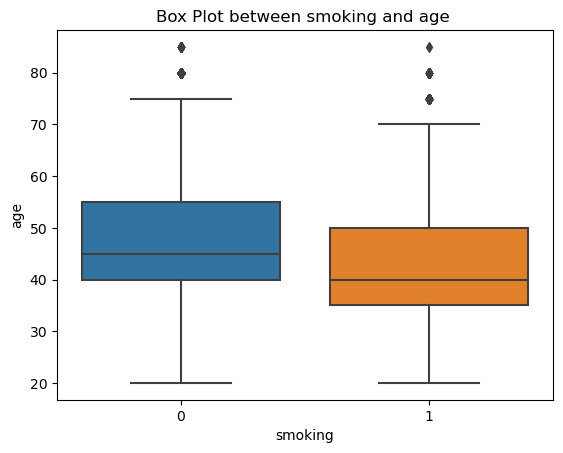

In [86]:
# Create a box plot between smoking and age
sns.boxplot(x="smoking", y="age", data=data)
plt.xlabel("smoking")
plt.ylabel("age")
plt.title("Box Plot between smoking and age ")
plt.show()

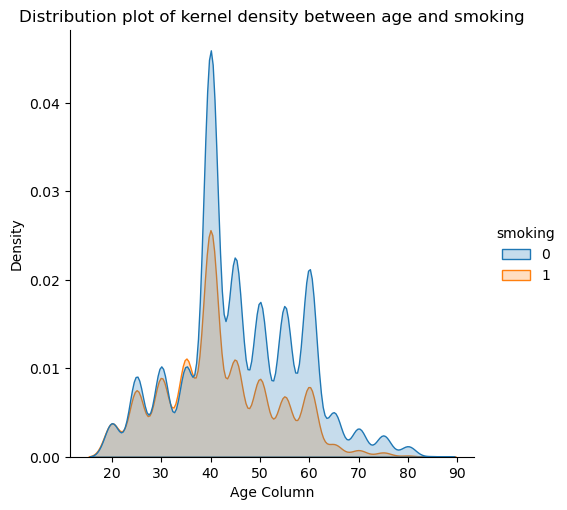

In [87]:
# Create a distribution plot between smoking and age
sns.displot(data=data, x='age', hue='smoking', kind='kde', fill=True)
plt.xlabel('Age Column')
plt.ylabel('Density')
plt.title('Distribution plot of kernel density between age and smoking')
plt.show()

#### 2. gender and smoking

In [78]:
data["smoking"] = data["smoking"].astype(str)

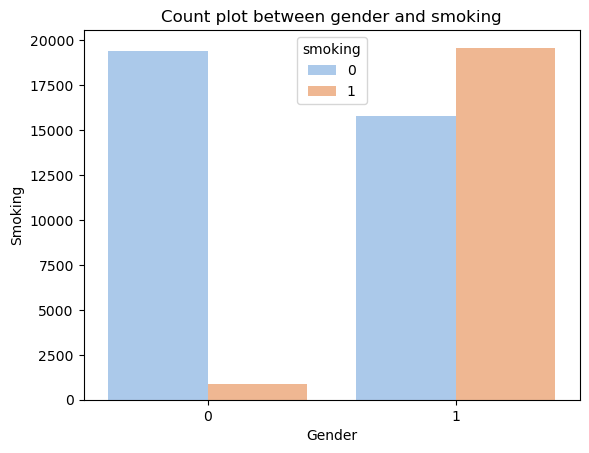

In [89]:
# Ստեղծենք  count plot gender-ի և smoking-ի միջև
sns.countplot(x="gender", hue="smoking", data=data, palette="pastel")
plt.xlabel("Gender")
plt.ylabel("Smoking")
plt.title("Count plot between gender and smoking")
plt.show()

In [36]:
# From this we can conclude that most men smoke and most women do not.
# But there are also some percentage of women who smoke.

#### 3. BMI, weight, waist, and smoking

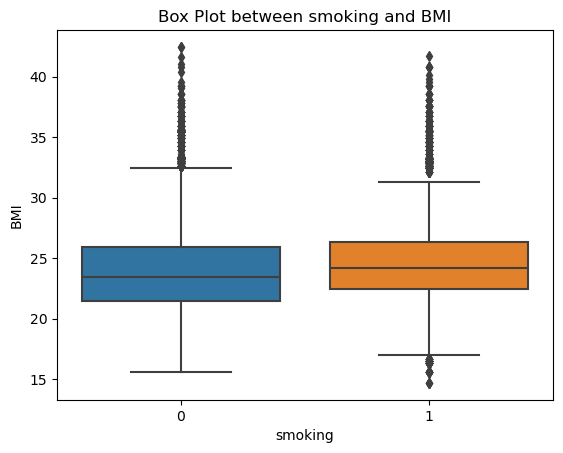

In [90]:
# Create a box plot between smoking and BMI
sns.boxplot(x="smoking", y="BMI", data=data)
plt.xlabel("smoking")
plt.ylabel("BMI")
plt.title("Box Plot between smoking and BMI")
plt.show()

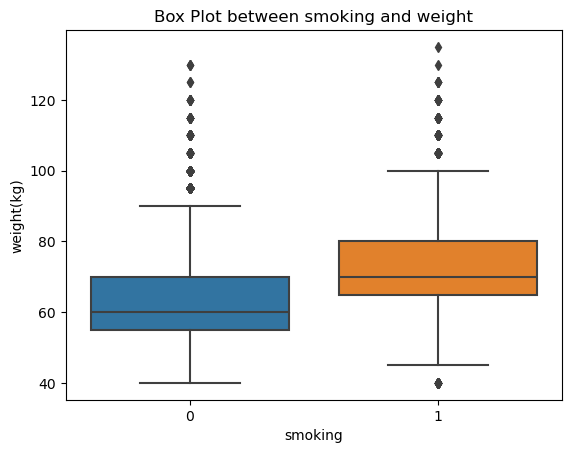

In [91]:
# Create a box plot between smoking and weight
sns.boxplot(x="smoking", y="weight(kg)", data=data)
plt.xlabel("smoking")
plt.ylabel("weight(kg)")
plt.title("Box Plot between smoking and weight")
plt.show()

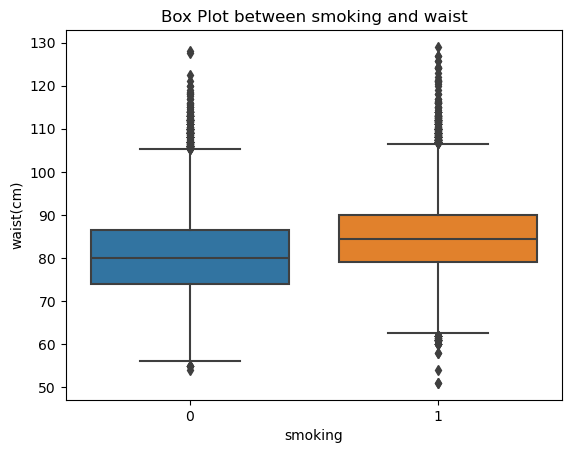

In [92]:
# Create a box plot between smoking and waist
sns.boxplot(x="smoking", y="waist(cm)", data=data)
plt.xlabel("smoking")
plt.ylabel("waist(cm)")
plt.title("Box Plot between smoking and waist")
plt.show()

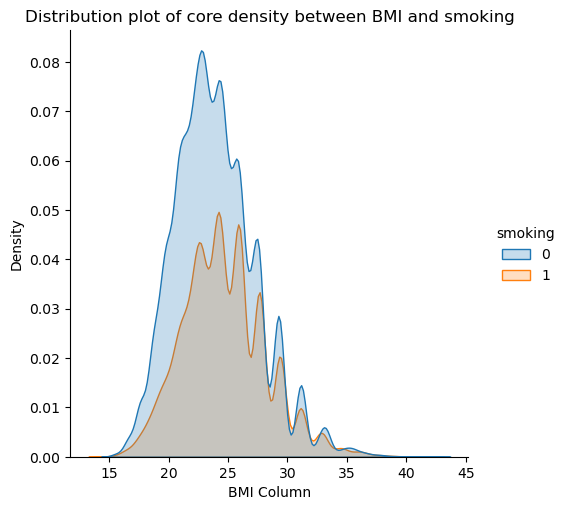

In [93]:
# Create a distribution plot between smoking and BMI
sns.displot(data=data, x="BMI", hue="smoking", kind="kde", fill=True)
plt.xlabel("BMI Column")
plt.ylabel("Density")
plt.title("Distribution plot of core density between BMI and smoking")
plt.show()

Text(0.5, 1.0, 'Kernel density distribution plot between weight(kg) and smoking')

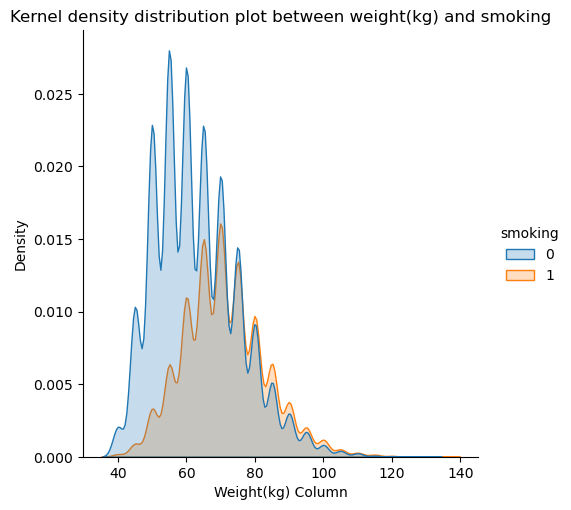

In [94]:
# Create a distribution plot between smoking and weight
sns.displot(data=data, x="weight(kg)", hue="smoking", kind="kde", fill=True)
plt.xlabel("Weight(kg) Column")
plt.ylabel("Density")
plt.title("Kernel density distribution plot between weight(kg) and smoking")

Text(0.5, 1.0, 'Kernel density distribution plot between waist(cm) and smoking')

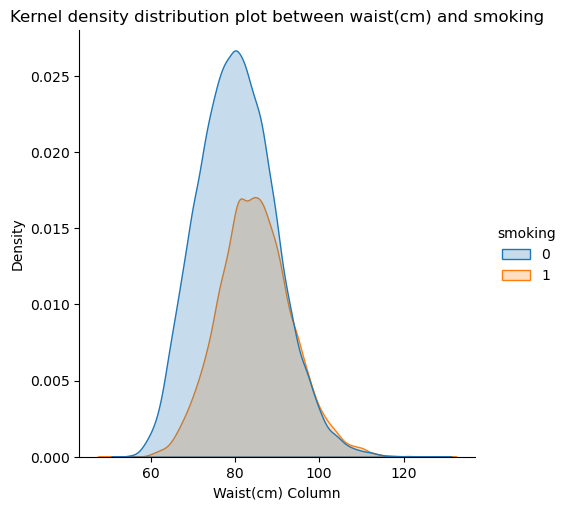

In [85]:
# Create a distribution plot between smoking and waist
sns.displot(data=data, x="waist(cm)", hue="smoking", kind="kde", fill=True)
plt.xlabel("Waist(cm) Column")
plt.ylabel("Density")
plt.title("Kernel density distribution plot between waist(cm) and smoking")

#### 4. Բոլոր հատկանիշները և smoking-ը

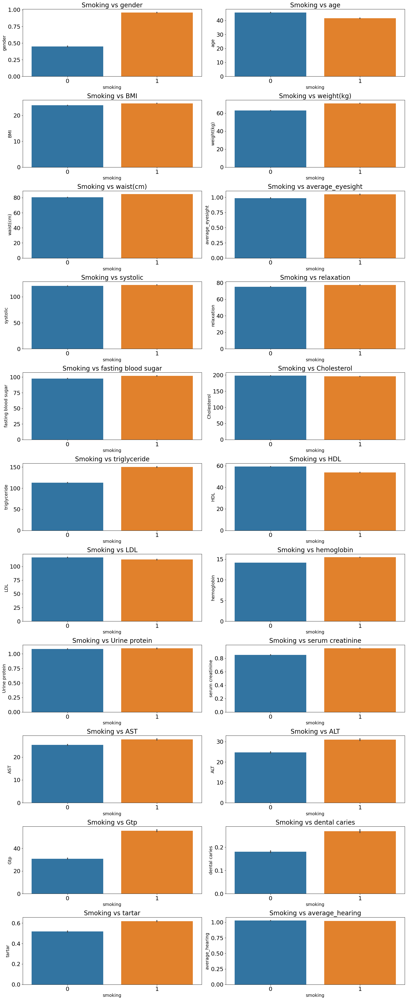

In [95]:
def plot_smoking(data):
    # Collect the broken columns in the sheet, except for ID and tuxedo
    columns_to_plot = data.columns[(data.columns != "smoking") & (data.columns != "ID")]
    
    # Set the row and column values
    row_num = len(columns_to_plot)//2
    column_num = 2

    # Create a subplot
    fig, axes = plt.subplots(row_num, column_num, figsize=(18, 4*row_num))

    axes = axes.flatten()

    # Loop over the lines and create bar plots
    for i, column in enumerate(columns_to_plot):
        ax = axes[i]
        sns.barplot(x="smoking", y=column, data=data, ax=ax)
        ax.set_xlabel("smoking", fontsize=14)
        ax.set_ylabel(column, fontsize=14)
        ax.set_title(f"Smoking vs {column}", fontsize=20)

        # Set the font size of the 2 labels: x and y
        ax.tick_params(axis="both", labelsize=18)

    # Delete some empty subplots
    for j in range(len(columns_to_plot), len(axes)):
        fig.delaxes(axes[j])
        
    # Adjust the layout and display the plots
    plt.tight_layout()
    plt.show()

# Call the function for our database
plot_smoking(data)

In [44]:
# Now looking at the graphs of each attribute and tuxedo and comparing the difference in their heights,
# we can conclude which specific characteristics influence smoking more and which less.

# Columns that do not have much effect on smoking
# 1. age (partially)
# 2. BMI
# 3. waist
# 4. avg. eye and hearing
# 5. systolic
# 6. diastolic
# 7. fasting blood sugar
# 8. cholestrol
# 9. HDL
# 10. LDL
# 11. hemoglobin
# 12. Urine protien
# 13. AST
# 14. serum creatinine


# Columns that are highly influenced by smoking
# 1. gender : males
# 2. weight : 62 to above
# 3. waist : 80 to above
# 4. triglyceride : 118 above
# 5. ALT : 25 to above
# 6. GTP : 31 to above
# 7. dental caires : 0.2 to above
# 8. tartar : 0.52 to above
# 9. chest pain : 3.5 to above
# 10. shortness of breath : 3 to above


#### 5. Which columns have the same effect for forecasting?

In [96]:
def scatter_plot_columns(data):
    # Exclude gender' and 'smoking' columns from numeric columns
    numeric_columns = [i for i in data.columns if i not in ['gender', 'smoking' ,'ID']]
    num_cols = len(numeric_columns)
    
    # Count the number of rows and columns of subplots
    num_rows = int(math.ceil(num_cols / 2))  # 2 scatter plot per line
    
    # Create all possible unique pairs for each number column
    fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(12, num_rows * 5))

    for i, ax_row in enumerate(axes):
        for j, ax in enumerate(ax_row):
            if i * 2 + j < num_cols:
                pair = itertools.islice(itertools.combinations(numeric_columns, 2), i * 2 + j, i * 2 + j + 1).__next__()
                sns.scatterplot(x=pair[0], y=pair[1], data=data, ax=ax)
                ax.set_xlabel(pair[0])
                ax.set_ylabel(pair[1])
                ax.set_title(f'Scatter Plot: {pair[0]} vs {pair[1]}')
            else:
                ax.axis('off') 
    
    # Adjust the layout
    plt.tight_layout()
    
    # Display the plots
    plt.show()

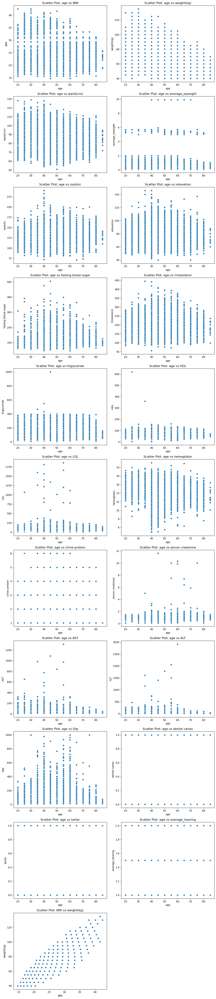

In [97]:
scatter_plot_columns(data)

## Data preprocessing

### handeling outliers

In [98]:
data

,ID,gender,age,BMI,weight(kg),waist(cm),average_eyesight,systolic,relaxation,fasting blood sugar,Cholesterol,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,tartar,smoking,average_hearing
0,0,0,40,24.973985,60,81.3,1.1,114.0,73.0,94.0,215.0,82.0,73.0,126.0,12.9,1.0,0.7,18.0,19.0,27.0,0,1,0,1.0
1,1,0,40,23.437500,60,81.0,0.7,119.0,70.0,130.0,192.0,115.0,42.0,127.0,12.7,1.0,0.6,22.0,19.0,18.0,0,1,0,1.0
2,2,1,55,20.761246,60,80.0,0.8,138.0,86.0,89.0,242.0,182.0,55.0,151.0,15.8,1.0,1.0,21.0,16.0,22.0,0,0,1,1.0
3,3,1,40,25.711662,70,88.0,1.5,100.0,60.0,96.0,322.0,254.0,45.0,226.0,14.7,1.0,1.0,19.0,26.0,18.0,0,1,0,1.0
4,4,0,40,24.973985,60,86.0,1.0,120.0,74.0,80.0,184.0,74.0,62.0,107.0,12.5,1.0,0.6,16.0,14.0,22.0,0,0,0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,0,40,22.491349,65,75.0,0.9,110.0,68.0,89.0,213.0,99.0,75.0,118.0,12.3,1.0,0.6,14.0,7.0,10.0,1,1,0,1.0
55688,55681,0,45,19.531250,50,70.0,1.2,101.0,62.0,89.0,166.0,69.0,73.0,79.0,14.0,1.0,0.9,20.0,12.0,14.0,0,1,0,1.0
55689,55683,0,55,19.531250,50,68.5,1.1,117.0,72.0,88.0,158.0,77.0,79.0,63.0,12.4,1.0,0.5,17.0,11.0,12.0,0,0,0,1.0
55690,55684,1,60,22.038567,60,78.0,0.9,133.0,76.0,107.0,210.0,79.0,48.0,146.0,14.4,1.0,0.7,20.0,19.0,18.0,0,0,0,1.0


In [99]:
value_counts_dict = value_counts_func(data)
value_counts_dict

{'ID': ID
 0        1
 46399    1
 46385    1
 46387    1
 46388    1
         ..
 23179    1
 23181    1
 23182    1
 23183    1
 55691    1
 Name: count, Length: 55642, dtype: int64,
 'gender': gender
 1    35401
 0    20241
 Name: count, dtype: int64,
 'age': age
 40    15172
 45     7030
 60     6158
 50     5544
 55     5012
 35     4480
 30     4056
 25     3525
 20     1605
 65     1336
 70      825
 75      607
 80      277
 85       15
 Name: count, dtype: int64,
 'BMI': BMI
 24.221453    2451
 22.491349    2203
 23.875115    2154
 23.437500    2071
 22.038567    2070
              ... 
 39.062500       1
 39.792388       1
 41.015625       1
 40.404040       1
 40.123457       1
 Name: count, Length: 137, dtype: int64,
 'weight(kg)': weight(kg)
 65     8196
 60     8139
 70     7722
 55     7326
 75     6088
 50     5563
 80     4117
 85     2529
 45     2367
 90     1477
 95      816
 40      468
 100     436
 105     200
 110     113
 115      49
 120      23
 125       8
 

In [100]:
def box_plot(columns):
    #Create subplots
    figure = make_subplots(rows=1, cols=len(columns))

    # Let's cycle over the columns
    for i, col in enumerate(columns):
        box_trace = go.Box(y=data[col], name=col )
        figure.add_trace(box_trace, row=1, col=i+1)
        figure.update_xaxes(title_text=col, row=1, col=i+1)


    figure.update_layout(title='Box Plots', height=600, width=50 * len(columns))
    figure.update_yaxes(title_text='Values')
    plt.tight_layout()
    
    return figure.show()

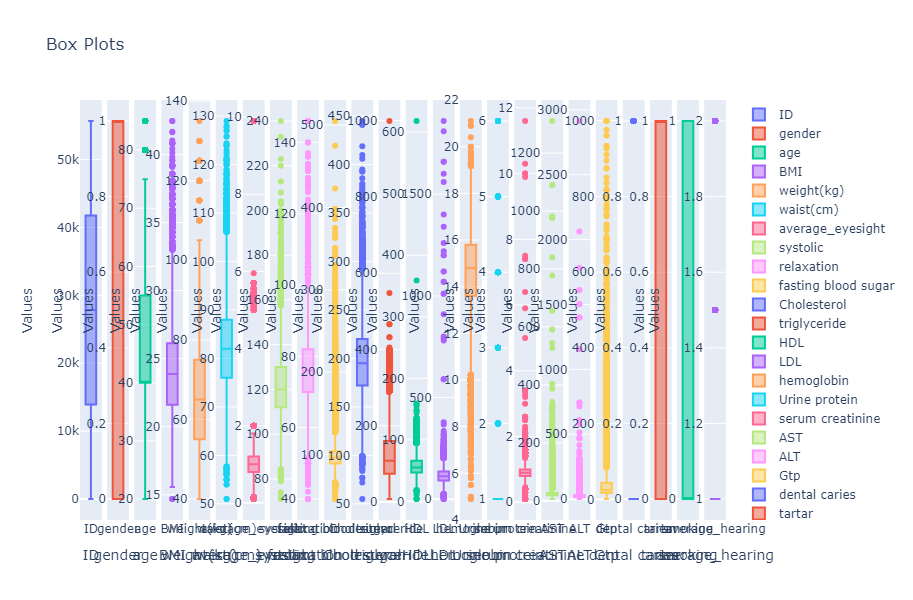

<Figure size 640x480 with 0 Axes>

In [102]:
box_plot(data.columns)
plt.show()

In [27]:
def drop_outliers(data, column_name=None, lower_bound=None, upper_bound=None):
    if column_name is None:
        raise ValueError("Please specify the column name")
    if lower_bound is not None and upper_bound is not None:
        mask = (data[column_name]>=lower_bound) & (data[column_name] <= upper_bound)
    elif lower_bound is not None:
        mask = (data[column_name] >= lower_bound)
    elif upper_bound is not None:
        mask = (data[column_name] <= upper_bound)
    else:
        raise ValueError("At least one of lower_bound or upper_bound must be provided")
    data_filtered = data[mask]
    return data_filtered

In [28]:
# systolic [80-220]
data=drop_outliers(data, column_name="systolic", lower_bound=80, upper_bound=220)

# fasting blood sugar
data= drop_outliers(data, column_name="fasting blood sugar", upper_bound=350)

# Cholesterol [400 as max]
data= drop_outliers(data, column_name="Cholesterol", upper_bound=400)

# triglyceride [432 as max]
data= drop_outliers(data, column_name="triglyceride", upper_bound=432)

# HDL [200 as max]
data= drop_outliers(data, column_name="HDL", upper_bound=200)

# LDL [500 as max]
data= drop_outliers(data, column_name="LDL", upper_bound=500)

# hemoglobin [6 as min]
data= drop_outliers(data, column_name="hemoglobin", lower_bound=6)

# serum creatinine [8 as max]
data= drop_outliers(data, column_name="serum creatinine", upper_bound=8)

# AST [600 as max]
data= drop_outliers(data, column_name="AST", upper_bound=600)

# ALT [1000 as max]
data= drop_outliers(data, column_name="ALT", upper_bound=1000)

In [29]:
data.shape

(55556, 24)

In [30]:
data.duplicated().any()
# No duplicate values

False

#### Correlation matrix

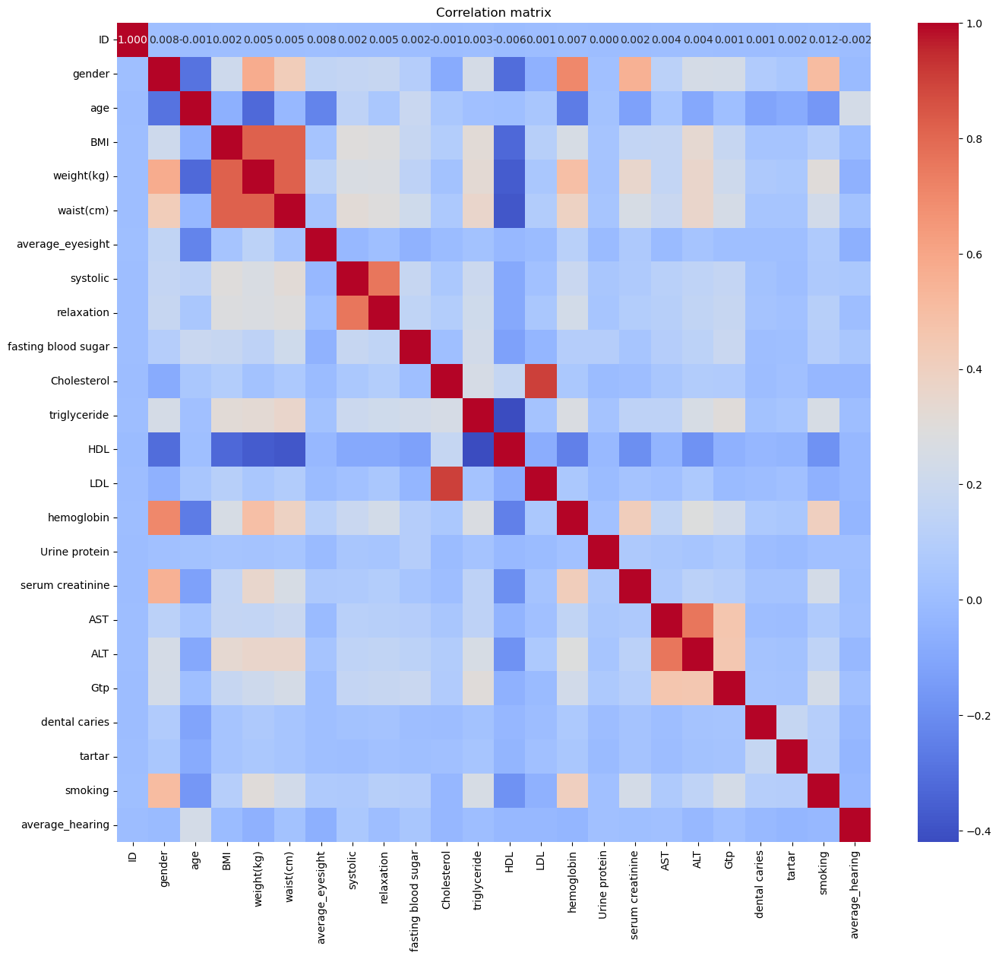

In [110]:
corr_matrix = data.corr()

plt.figure(figsize=(16, 14))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".3f")
plt.title("Correlation matrix")
plt.show()

## Modelling

## Decision Tree

## Tree 1

In [112]:
data1 = data.copy()

In [113]:
# X contains variables (all columns except smoking and ID columns)
x = data1.drop(columns=["smoking", "ID"])

# y contains the target column
y = data1["smoking"]

In [114]:
# Split the data into train and test parts
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [116]:
#Creating a decision tree
clf=tree.DecisionTreeClassifier()

In [117]:
#Training the model
clf.fit(x_train, y_train)

DecisionTreeClassifier()

In [118]:
#Prediction based on training data
clf.score(x_train, y_train)

1.0

In [119]:
clf.score(x_test,y_test)

0.7785277177825773

In [120]:
#Model quality accuracy coefficient (Precession)
y_pred = clf.predict(x_test)
precision_score(y_test, y_pred, pos_label="1")

0.7033773861967695

In [121]:
#Quality coefficient of the model, which shows the correct answers (Recall)
recall_score(y_test, y_pred, pos_label="1")

0.6970652437545477

In [122]:
# Calculate the total F1 score for the model
from sklearn.metrics import f1_score
f1_score(y_test, y_pred, pos_label="1")

0.7002070897795103

In [123]:
# Creating the confusion matrix
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[5777 1212]
 [1249 2874]]


In [124]:
#Probability of classifying "bad" and "good" groups in the model
y_predicted=clf.predict_proba(x_test)
y_predicted

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       ...,
       [0., 1.],
       [0., 1.],
       [1., 0.]])

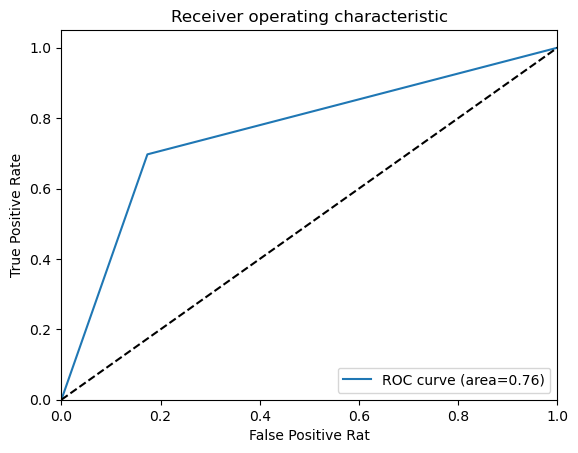

In [125]:
#Creating an ROC curve
fpr, tpr, thresholds=roc_curve(y_test,y_predicted[:,1], pos_label="1")
roc_auc=auc(fpr, tpr)
plt.figure()
plt.plot(fpr,tpr,label='ROC curve (area=%0.2f)' %(roc_auc))
plt.plot([0,1],[0,1],'k--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rat')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

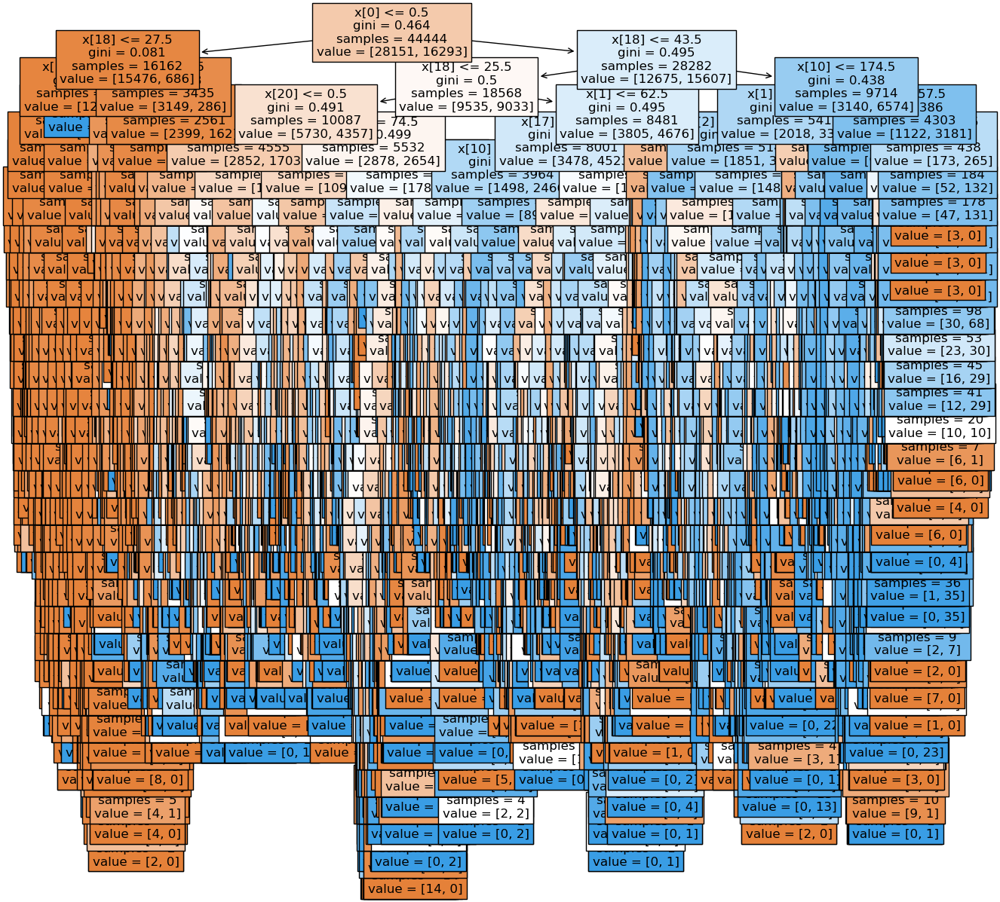

In [126]:
# Decision tree diagram
plt.figure(figsize=(15,15))
tree.plot_tree(clf, filled=True, fontsize=12)
plt.show()

In [127]:
# Presentation of a report on the quality of the model
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.82      0.83      0.82      6989
           1       0.70      0.70      0.70      4123

    accuracy                           0.78     11112
   macro avg       0.76      0.76      0.76     11112
weighted avg       0.78      0.78      0.78     11112



## Tree 2

In [128]:
#Creating a decision tree
clf2=tree.DecisionTreeClassifier()

In [129]:
#Creating a library of decision tree parameters
parametrs={'criterion':['gini','entropy'],'max_depth':range(1,100)}

In [130]:
#Find parameters for best results using cross-validation
grid_search_cv_clf=GridSearchCV(clf2,parametrs,cv=5)

In [131]:
#Training the model
grid_search_cv_clf.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(1, 100)})

In [133]:
#Parameters for best model output
grid_search_cv_clf.best_params_

{'criterion': 'entropy', 'max_depth': 28}

In [134]:
# Saving the created tree with depth 28
best_clf=grid_search_cv_clf.best_estimator_

In [135]:
#Prediction based on training data
best_clf.score(x_train, y_train)

0.9955449554495545

In [136]:
#Prediction based on test data
best_clf.score(x_test,y_test)

0.7814974802015838

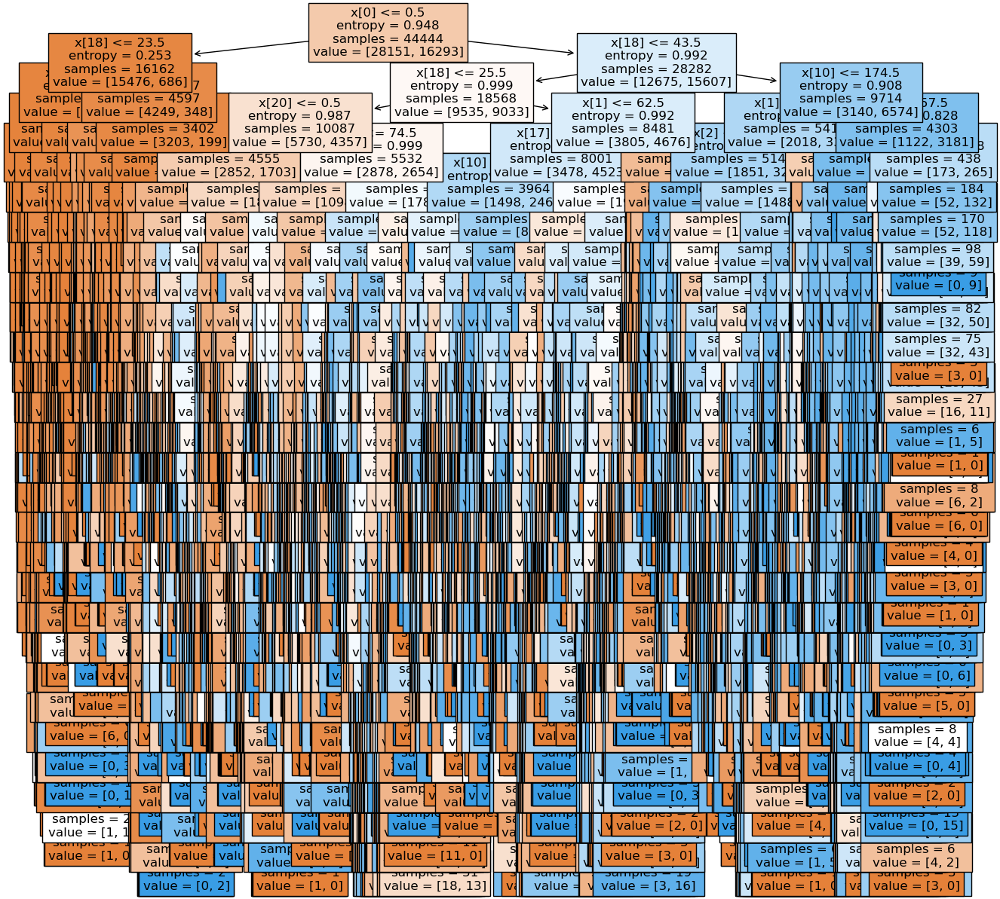

In [137]:
# Decision tree diagram
plt.figure(figsize=(15,15))
tree.plot_tree(best_clf, filled=True, fontsize=12)
plt.show()

In [139]:
#Model quality accuracy coefficient (Precession)
y_pred2=best_clf.predict(x_test)
precision_score(y_test, y_pred2,  pos_label="1")

0.7067577457916565

In [140]:
#Quality coefficient of the model, which shows the correct answers (Recall)
recall_score(y_test, y_pred2,  pos_label="1")

0.7026437060392918

In [141]:
#Probability of classifying "bad" and "good" groups in the model
y_predicted2=best_clf.predict_proba(x_test)
y_predicted2

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       ...,
       [0., 1.],
       [0., 1.],
       [1., 0.]])

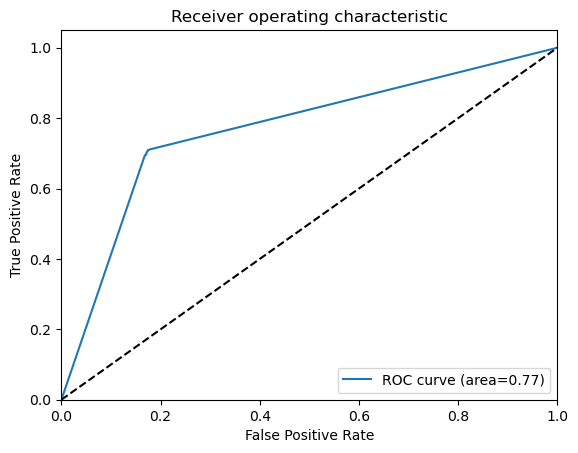

In [142]:
#Creating an ROC curve
fpr, tpr, thresholds=roc_curve(y_test,y_predicted2[:,1],  pos_label="1")
roc_auc=auc(fpr, tpr)
plt.figure()
plt.plot(fpr,tpr,label='ROC curve (area=%0.2f)' %(roc_auc))
plt.plot([0,1],[0,1],'k--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

In [143]:
# Presentation of a report on the quality of the model
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred2))

              precision    recall  f1-score   support

           0       0.83      0.83      0.83      6989
           1       0.71      0.70      0.70      4123

    accuracy                           0.78     11112
   macro avg       0.77      0.77      0.77     11112
weighted avg       0.78      0.78      0.78     11112



In [144]:
# Calculation of generalization F1 score for the model
f1_score(y_test, y_pred2,  pos_label="1")

0.704694721478959

## Random Forest

In [4]:
# Creating a forest
clf_rf=RandomForestClassifier()

In [5]:
parametrs={"n_estimators":[10, 20, 30], "max_depth":range(1, 50)}

In [6]:
#Find parameters for best results using cross-validation
grid_search_cv_clf=GridSearchCV(clf_rf, parametrs, cv=5)

In [38]:
data2 = data.copy()

In [39]:
#For model training, dividing the available data into training (60%) and testing (40%) parts
x_r = data2.drop(columns=["smoking", "ID"])

# y contains the target column
y_r = data2["smoking"]
x_train_r, x_test_r, y_train_r, y_test_r = train_test_split(x_r,y_r, test_size=0.4)

In [40]:
#Training the model
grid_search_cv_clf.fit(x_train_r, y_train_r)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': range(1, 50),
                         'n_estimators': [10, 20, 30]})

In [41]:
# Setting the parameters for the best model output
grid_search_cv_clf.best_params_

{'max_depth': 44, 'n_estimators': 30}

In [42]:
#Saving created forest with depth 5 and number of trees 20
best_clf=grid_search_cv_clf.best_estimator_

In [44]:
#Prediction based on training data
best_clf.score(x_train_r, y_train_r)

0.999279992799928

In [45]:
#Prediction based on test data
best_clf.score(x_test_r,y_test_r)

0.8052468163614274

In [46]:
feature_importances=best_clf.feature_importances_
feature_importances_df=pd.DataFrame({'features':list(x_train_r),'feature_importances':feature_importances})
feature_importances_df.sort_values('feature_importances', ascending=False)

,features,feature_importances
0,gender,0.151539
13,hemoglobin,0.093862
18,Gtp,0.086325
10,triglyceride,0.065823
12,LDL,0.047495
9,Cholesterol,0.046561
17,ALT,0.045974
4,waist(cm),0.045093
8,fasting blood sugar,0.044790
11,HDL,0.044352


In [48]:
#Մոդելի որակի ճշգրտության գործակից (Precesion)
y_pred2=best_clf.predict(x_test_r)
precision_score(y_test_r, y_pred2)

0.7391358177541166

In [49]:
#Մոդելի որակի գործակից, որը ցույց է տալիս ճիշտ գտնված պատասխանները (Recall)
recall_score(y_test_r, y_pred2)

0.7288487364180197

In [51]:
# Մոդելի համար ընդհանում F1 score-ի հաշվարկ
f1_score(y_test_r, y_pred2)

0.7339562330956478

In [52]:
# Շփոթության մատրիցաի ստեղծում
from sklearn.metrics import confusion_matrix

confusion_matrix = confusion_matrix(y_test_r, y_pred2)
print(confusion_matrix)

[[11925  2107]
 [ 2221  5970]]


In [53]:
# Մոդելի որակի վերաբերյալ հաշվետվության ներկայացում
from sklearn.metrics import classification_report
print(classification_report(y_test_r, y_pred2))

              precision    recall  f1-score   support

           0       0.84      0.85      0.85     14032
           1       0.74      0.73      0.73      8191

    accuracy                           0.81     22223
   macro avg       0.79      0.79      0.79     22223
weighted avg       0.80      0.81      0.80     22223



In [54]:
#Մոդելում "վատ" և "լավ" խմբերի դասակարգման հավանականություն
y_predicted2=best_clf.predict_proba(x_test_r)
y_predicted2

array([[0.86666667, 0.13333333],
       [0.93333333, 0.06666667],
       [1.        , 0.        ],
       ...,
       [0.93333333, 0.06666667],
       [0.83333333, 0.16666667],
       [0.33333333, 0.66666667]])

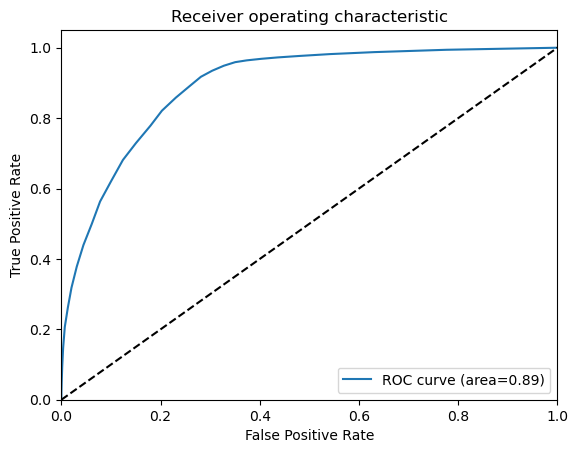

In [57]:
#ROC կորի ստեղծում
fpr, tpr, thresholds=roc_curve(y_test_r,y_predicted2[:,1])
roc_auc=auc(fpr, tpr)
plt.figure()
plt.plot(fpr,tpr,label='ROC curve (area=%0.2f)' %(roc_auc))
plt.plot([0,1],[0,1],'k--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")

## Neural Network 

In [82]:
data3 = data.copy()

In [83]:
# Preprocessing

x_n = data3.drop(columns=["smoking", "ID"])
y_n = data["smoking"]

In [86]:
# Split the data into train and test parts
x_train_n, x_test_n, y_train_n, y_test_n = train_test_split(x_n, y_n, test_size=0.2, random_state=46)

In [87]:
# Standardizing features

scaler = StandardScaler()
x_train_n = scaler.fit_transform(x_train_n)
x_test_n = scaler.transform(x_test_n)

In [88]:
# Create the neural network model
model = keras.Sequential([
    layers.Dense(64, activation='relu', input_shape=[x_train_n.shape[1]]),
    layers.Dense(64, activation='relu'),
    layers.Dense(1, activation='sigmoid')
])

In [89]:
# Compile the model
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

In [90]:
# Define LabelEncoder
label_encoder = LabelEncoder()

# Encode the target variable
y_train_encoded = label_encoder.fit_transform(y_train_n)

# Make sure target variable is converted to float
y_train_float = y_train_encoded.astype(float)

In [91]:
# Model training
history = model.fit(x_train_n, y_train_float, epochs=50, batch_size=32, validation_split=0.2)

Epoch 1/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - accuracy: 0.7328 - loss: 0.4954 - val_accuracy: 0.7561 - val_loss: 0.4630
Epoch 2/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.7621 - loss: 0.4575 - val_accuracy: 0.7609 - val_loss: 0.4577
Epoch 3/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.7706 - loss: 0.4522 - val_accuracy: 0.7590 - val_loss: 0.4569
Epoch 4/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.7680 - loss: 0.4495 - val_accuracy: 0.7579 - val_loss: 0.4548
Epoch 5/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.7765 - loss: 0.4451 - val_accuracy: 0.7597 - val_loss: 0.4598
Epoch 6/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7697 - loss: 0.4490 - val_accuracy: 0.7623 - val_loss: 0.4539
Epoch 7/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.7777 - loss: 0.4417 - val_accuracy: 0.7614 - val_loss: 0.4567
Epoch 8/50
1112/1112 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.7786 - loss: 0.4413 - 

In [93]:
# Define LabelEncoder
label_encoder = LabelEncoder()

# Encode the target variableը
y_test_encoded = label_encoder.fit_transform(y_test_n)

# Make sure target variable is converted to float
y_test_float = y_test_encoded.astype(float)

In [94]:
# Evaluate the quality of the model
test_loss, test_acc = model.evaluate(x_test_n, y_test_float)
print(f'Test accuracy: {test_acc}')

348/348 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.7583 - loss: 0.5122
Test accuracy: 0.7554895877838135
